<a href="https://colab.research.google.com/github/bevanscu/projects-share/blob/main/FNCE24_Final_Project_DSA_8_19_8pm_WIP.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

## FNCE 2431 Final Project Group-1
LU: 8/17/2022

## Installs, supporting packages and libraries

In [ ]:
%%capture
!pip install pandas_ta
!pip install dash -q
!pip install dash-bootstrap-components
!pip install jupyter-dash -q
!pip install yfinance
!pip install xgboost
!pip install ta
import yfinance as yf
#!pip install dash-cystoscape
from dash.dependencies import Input, Output
from dash import no_update
import pandas_ta as ta
import pandas as pd
import numpy as np
import math
import os
import plotly.express as px
import plotly.graph_objects as go
from pathlib import Path
from ta import add_all_ta_features
from scipy import stats

In [ ]:
%%capture
!pip install scikit-plot
import matplotlib.pyplot as plt
import seaborn as sns
import xgboost
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import MinMaxScaler
from scikitplot.metrics import plot_roc
from scikitplot.metrics import plot_precision_recall
from scikitplot.metrics import plot_cumulative_gain
from scikitplot.metrics import plot_lift_curve
from sklearn.metrics import plot_confusion_matrix
from sklearn.metrics import roc_auc_score
from sklearn.metrics import roc_curve, auc
from sklearn.metrics import confusion_matrix
import statsmodels.api as sm
from sklearn.ensemble import GradientBoostingClassifier
from sklearn.metrics import accuracy_score
from sklearn.metrics import classification_report
from sklearn.ensemble import GradientBoostingClassifier
from xgboost import XGBClassifier
from sklearn.naive_bayes import GaussianNB


In [ ]:
#Basic lines of code needed to import a data file with permissions from Google Drive
#from google.colab import drive
#drive.mount("/content/drive", force_remount=True)
#drive.mount('/content/drive')
#os.chdir("drive/My Drive/FNCE2431Group_1/Course_Content_Notebooks_Plus/")

## Data Acquisition: Stock (df is the complete dataframe)

In [ ]:
stocks = ['AAPL', 'MSFT', 'GOOG', 'NVDA', 'META', 'ASML', 'AVGO', 'ORCL',
       'ADBE', 'CRM', 'AMZN', 'TSLA', 'TSM', 'TCEHY', 'BABA', 'CSCO',
       'QCOM', 'TXN', 'AMD', 'INTC', 'CDNS', 'ADP', 'NFLX', 'NOW', 'INTU',
       'IBM', 'PYPL', 'SAP', 'SONY', 'JD', 'AMAT', 'ADI', 'ADSK', 'BKNG',
       'MRVL', 'LRCX', 'MU', 'TEAM', 'FISV', 'EQIX', 'ATVI', 'VMW',
       'NTES', 'FIS', 'KLAC', 'SNPS', 'PANW', 'SHOP', 'MELI', 'SQ']

# Will use these groupings
dict_stocks = {"All" : stocks,
               "Group 1 (FAANG)" : ["Meta","AMZN","AAPL", "NFLX", "GOOG"],
               "Group 2 (Other)" : ["TSLA","AMD","VMW", "PANW", "IBM", "CSCO", "BABA", "NOW", "SHOP", "SQ"]}


In [ ]:
%%capture
p = []
start_date='2016-01-01'
end_date = '2022-01-01'
for i in stocks:
    test = yf.download(i, start = start_date, end = end_date, period = '1d')[["Open","Close","High", "Low", "Volume","Adj Close"]]
    test["Ticker"] = i
    p.append(test)
p = pd.concat(p)
df= pd.DataFrame(p)
df = df[["Ticker","Open","Close","High", "Low", "Volume","Adj Close"]]


In [ ]:
df.shape

(75550, 7)

In [ ]:
pd.set_option('display.max_columns', None)

## Feature Setup across stocks
18 self-selected features (variants of RSI, SMA, EMA, Lag, and MFI)

In [ ]:
%%capture
# feature setup across all stocks
df['log_adj_price'] = df.groupby('Ticker')['Adj Close'].transform(lambda x: np.log(x))    
df['RSI_2'] = df.groupby('Ticker')['Adj Close'].transform (lambda x: ta.rsi(x,length = 2)) 
df['RSI_3'] = df.groupby('Ticker')['Adj Close'].transform (lambda x: ta.rsi(x,length = 3)) 
df['RSI_5'] = df.groupby('Ticker')['Adj Close'].transform (lambda x: ta.rsi(x,length = 5)) 
df['RSI_6'] = df.groupby('Ticker')['Adj Close'].transform (lambda x: ta.rsi(x,length = 6)) 
df['RSI_14'] = df.groupby('Ticker')['Adj Close'].transform (lambda x: ta.rsi(x,length = 14)) 
df['SMA_5'] = df.groupby('Ticker')['Adj Close'].transform (lambda x: ta.sma(x, length = 5))
df['SMA_10'] = df.groupby('Ticker')['Adj Close'].transform (lambda x: ta.sma(x, length = 10))                                                      
df['SMA_20'] = df.groupby('Ticker')['Adj Close'].transform (lambda x: ta.sma(x, length = 20))                                                             
df['EMA_5'] = df.groupby('Ticker')['Adj Close'].transform (lambda x: ta.ema(x, length = 5))    
df['EMA_10'] = df.groupby('Ticker')['Adj Close'].transform (lambda x: ta.ema(x, length = 10)) 
df['EMA_20'] = df.groupby('Ticker')['Adj Close'].transform (lambda x: ta.ema(x, length = 20))  
df['Lag_1'] = df.groupby('Ticker')['Adj Close'].transform (lambda x: x.pct_change())
df['Lag_2'] = df.groupby('Ticker')['Adj Close'].transform (lambda x: x.pct_change(periods=2))
df['Lag_3'] = df.groupby('Ticker')['Adj Close'].transform (lambda x: x.pct_change(periods=3))
df['Lag_4'] = df.groupby('Ticker')['Adj Close'].transform (lambda x: x.pct_change(periods=4))
df['Lag_week'] = df.groupby('Ticker')['Adj Close'].transform (lambda x: x.pct_change(periods=5))
df['Lag_month'] = df.groupby('Ticker')['Adj Close'].transform (lambda x: x.pct_change(periods=20))

# Target setup
df['Target'] = df.groupby('Ticker')['Adj Close'].transform (lambda x: -1*x.pct_change(-1))
df['Target_class']= df.groupby('Ticker')['Target'].transform (lambda x: np.sign(x))


p = []
for s in stocks:
    temp = df[df["Ticker"] == s]
    temp['Ticker'] = s
    temp['MFI'] = ta.mfi(temp['High'], temp['Low'], temp['Adj Close'], temp['Volume'], length = 14)
    
    p.append(temp)
p = pd.concat(p)
df= pd.DataFrame(p)

df = df.dropna()
df['Target_class'] = df['Target_class'].astype(int)
df = df[abs(df['Target_class']) != 0]


## Augmented and clean feature set with the complete ta package all features
-https://technical-analysis-library-in-python.readthedocs.io/en/latest/ta.html

- Review feature and removed any conflicting or unwanted indicators
- Normalized only the 'normalizable' features

In [ ]:
# All all technical indicators from ta
df2 = add_all_ta_features(df, open = "Open", high = "High", low = "Low", close = "Adj Close", volume = "Volume")

/usr/local/lib/python3.7/dist-packages/ta/trend.py:769: RuntimeWarning: invalid value encountered in double_scalars
  dip[idx] = 100 * (self._dip[idx] / value)
/usr/local/lib/python3.7/dist-packages/ta/trend.py:774: RuntimeWarning: invalid value encountered in double_scalars
  din[idx] = 100 * (self._din[idx] / value)


In [ ]:
# Drop conflicting trend up/down indicators
df2.drop(['trend_psar_up','trend_psar_down','trend_psar_up_indicator','trend_psar_down_indicator'],axis = 1, inplace = True)

In [ ]:
z_feature_list = df2.columns.values.tolist()

In [ ]:
# Drop the columns not to be normalized (Ticker, High, Low, Adj Close, Volume, adj_log_price)
del z_feature_list[:8]

In [ ]:
# Drop the columns (Lag* and Target*) add'l excluded columns from normalization (zscore)
import re
regex1 = re.compile(r'Lag.*$')
regex2 = re.compile(r'Target.*$')
zfl_tmp = [i for i in z_feature_list if not regex1.match(i)]
zfl_tmp2 = [i for i in zfl_tmp if not regex2.match(i)]

z_feature_list = zfl_tmp2

In [ ]:
# Normalize select features 
df2[z_feature_list]= df2.groupby(['Ticker'])[z_feature_list].transform(lambda x : stats.zscore(x,axis=0, nan_policy = "omit"))

In [ ]:
df2.dropna(inplace = True)

In [ ]:
df.equals(df2)

True

### 6 years of data, holdback of 1yr (at the end)

In [ ]:
df.reset_index(inplace=True)
df.set_index(['Date'], inplace=True)
# 1yr holdback meant for production
holdback_1yr = df.tail(252)

In [ ]:
# dataset  without the holdback year
df = df.iloc[:-(len(holdback_1yr)), :]

### Utility functions to easily get selected tickers and X,y data


In [ ]:
# returns dataframe for selected tickers
# Usage: 
#   stocklist =  ['AAPL', 'MSFT', 'GOOG']
#   dftest = get_df_by_Tickers(df, stocklist)
def get_df_by_Tickers (df, tickers):
  df_tmp = []
  for s in tickers:
    temp = df[df["Ticker"] == s]
    temp['Ticker'] = s
    df_tmp.append(temp)
  df_tmp = pd.concat(df_tmp)
  df_out = pd.DataFrame(df_tmp)
  return df_out

In [ ]:
def balance_train_X_y (X_t, y_t):
  baldiff = sum(y_t == 1) - sum(y_t ==-1)
  dftrain = pd.concat([y_t, X_t], axis = 1)
  dfeven = dftrain.query("Target_class == -1").sample(n=baldiff, random_state = 1)
  dftrainup = dftrain.append(dfeven)
  X_train = dftrainup[feature_cols]
  y_train = dftrainup["Target_class"]
  return X_train, y_train

In [ ]:
# get X and Y training and test from a stocks df
# Usage:
#   X_train, X_test, y_train, y_test = get_X_y_train_test (df, ["RSI_1", "EMA_5"],.2)
#   shuffle set to False
def get_X_y_train_test (df, fcol_list, test_size):
  select_fcols = fcol_list
  y = df['Target_class']
  X = df[select_fcols]
  X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=test_size, shuffle=False)
  return X_train, X_test, y_train, y_test

In [ ]:
# Split Target into 3 classes
def get_tri_state(x, threshold):
    if x['Target']> threshold:
        return 1
    elif x['Target']< -threshold:
        return -1
    else:
        return 0

In [ ]:
def results_summary (model, X_tr, y_tr, X_t, y_t):
  y_pr = model.predict(X_t)
  y_pr_proba = model.predict_proba(X_t)
  print(type(model).__name__)
  print("Accuracy score (training): ", model.score(X_tr, y_tr))
  print("Accuracy score (validation): ",model.score(X_t, y_t))
  print(classification_report(y_t, y_pr))
  print("Confusion Matrix\n")
  print(confusion_matrix(y_t, y_pr))
  cf_matrix = confusion_matrix(y_t, y_pr)
  ax = sns.heatmap(cf_matrix/np.sum(cf_matrix), annot=True, 
                                    fmt='.2%', cmap='Blues')

  ax.set_title(type(model).__name__ + ' Confusion Matrix\n\n');
  ax.set_xlabel('\nPredicted Values')
  ax.set_ylabel('Actual Values ');
  return y_pr, y_pr_proba


### Adding a three class target up, flat, down

In [ ]:
# most 75% @ .011
df['Target'].describe()

count    72396.000000
mean         0.000965
std          0.023054
min         -0.399806
25%         -0.008669
50%          0.001526
75%          0.011723
max          0.343358
Name: Target, dtype: float64

In [ ]:
df['TRI_Target'] = df.apply(lambda x: get_tri_state(x, .01), axis = 1)

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """Entry point for launching an IPython kernel.


In [ ]:
df['TRI_Target'].value_counts().sort_index()

-1    16449
 0    35420
 1    20527
Name: TRI_Target, dtype: int64

In [ ]:
# Changes in 'd' are not reflected in original df
import copy
d = copy.deepcopy(df)
d['Target_class'] = df['TRI_Target']

In [ ]:
# create the feature/predictor columns remove unnecessary
feature_cols = d.columns
feature_cols = feature_cols.drop(labels=['Target_class', 'Target', 'Ticker','Open', 'Adj Close','Close', 'High', 'Low', 'Volume', 'log_adj_price', 'TRI_Target']).values.tolist()

In [ ]:
X_train, X_test, y_train, y_test = get_X_y_train_test (d, feature_cols, .2)

## ML Setup

### Packages, Learners, and Plotting

In [ ]:
%%capture
!pip install scikit-plot
!pip install xgboost
!pip install scikit-optimize
from imblearn.combine import SMOTEENN 
from sklearn.linear_model import LogisticRegression
from sklearn.neighbors import KNeighborsClassifier 
from sklearn.linear_model import LogisticRegression
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier, BaggingClassifier, GradientBoostingClassifier,AdaBoostClassifier
from xgboost import XGBClassifier

import statsmodels.api as sm
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import MinMaxScaler
from xgboost import XGBClassifier

import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import MinMaxScaler
from scikitplot.metrics import plot_roc
from scikitplot.metrics import plot_precision_recall
from scikitplot.metrics import plot_cumulative_gain
from scikitplot.metrics import plot_lift_curve
from sklearn.metrics import plot_confusion_matrix
from sklearn.metrics import roc_auc_score
from sklearn.metrics import roc_curve, auc
from sklearn.metrics import confusion_matrix
import statsmodels.api as sm


### Train, Test, Split on initial feature selection and balance training data

In [ ]:
# create the feature/predictor columns remove unnecessary
feature_cols = d.columns
feature_cols = feature_cols.drop(labels=['Target_class', 'Target', 'Ticker','Open', 'Adj Close','Close', 'High', 'Low', 'Volume', 'log_adj_price', 'TRI_Target']).values.tolist()


In [ ]:
pd.set_option('display.max_columns', None)

In [ ]:
# X, y imbalanced
X_trainub, X_testub, y_trainub, y_testub = get_X_y_train_test (df, feature_cols, .2)

In [ ]:
# X, y balanced 
X_train, X_test, y_train, y_test = get_X_y_train_test (df, feature_cols, .2)
X_train, y_train = balance_train_X_y (X_train, y_train)

# X and y for production/holdback
X_hold = holdback_1yr[feature_cols]
y_hold = holdback_1yr["Target_class"]

In [ ]:
df['Target_class'].value_counts()

 1    39390
-1    33006
Name: Target_class, dtype: int64

In [265]:
(unique, counts) = np.unique(y_train, return_counts=True)
frequencies = np.asarray((unique, counts)).T
print("Training Freq:\n",frequencies)

Training Freq:
 [[   -1 31438]
 [    1 31438]]


In [ ]:
# initial GB model
#gb_model = GradientBoostingClassifier(n_estimators=20, random_state=0, verbose=1)

model_gb_init = GradientBoostingClassifier(n_estimators=20,random_state=0,verbose=1)

model_gb_tuned = GradientBoostingClassifier(n_estimators=50, 
                                  learning_rate=.5, max_features=3, 
                                  max_depth=2, random_state=0,verbose=1)

model_gb_init.fit(X_train, y_train)
model_gb_tuned.fit(X_train, y_train)




      Iter       Train Loss   Remaining Time 
         1           1.3851           41.53s
         2           1.3840           39.25s
         3           1.3828           37.20s
         4           1.3819           34.98s
         5           1.3809           32.77s
         6           1.3803           30.58s
         7           1.3796           28.75s
         8           1.3788           26.79s
         9           1.3782           24.45s
        10           1.3775           22.20s
        20           1.3729            0.00s
      Iter       Train Loss   Remaining Time 
         1           1.3839            2.46s
         2           1.3825            2.61s
         3           1.3817            2.59s
         4           1.3811            2.54s
         5           1.3802            2.43s
         6           1.3797            2.41s
         7           1.3790            2.34s
         8           1.3784            2.27s
         9           1.3775            2.25s
        

GradientBoostingClassifier(learning_rate=0.5, max_depth=2, max_features=3,
                           n_estimators=50, random_state=0, verbose=1)

In [ ]:
gb1 = GradientBoostingClassifier(n_estimators=500,random_state=0,verbose=1)
gb1.fit(X_train, y_train)

      Iter       Train Loss   Remaining Time 
         1           1.3851           18.70m
         2           1.3840           18.45m
         3           1.3828           18.39m
         4           1.3819           18.32m
         5           1.3809           18.28m
         6           1.3803           18.22m
         7           1.3796           18.17m
         8           1.3788           18.12m
         9           1.3782           18.07m
        10           1.3775           18.03m
        20           1.3729           17.84m
        30           1.3695           17.31m
        40           1.3664           17.00m
        50           1.3639           16.70m
        60           1.3613           16.34m
        70           1.3589           15.91m
        80           1.3566           15.55m
        90           1.3546           15.16m
       100           1.3525           14.79m
       200           1.3326           11.05m
       300           1.3149            7.35m
       40

GradientBoostingClassifier(n_estimators=500, random_state=0, verbose=1)

In [ ]:
import pickle
with open('gb_model.pkl' , 'wb') as f:
  pickle.dump(gb1, f)

# load saved model
with open('gb_model.pkl' , 'rb') as f:
  gb1_2class = pickle.load(f)

In [ ]:
model_dtc = DecisionTreeClassifier()
model_dtc.fit(X_train, y_train)

DecisionTreeClassifier()

### DecisionTree - in-sample

DecisionTreeClassifier
Accuracy score (training):  1.0
Accuracy score (validation):  0.5133977900552487
              precision    recall  f1-score   support

          -1       0.46      0.47      0.47      6528
           1       0.56      0.55      0.55      7952

    accuracy                           0.51     14480
   macro avg       0.51      0.51      0.51     14480
weighted avg       0.51      0.51      0.51     14480

Confusion Matrix

[[3096 3432]
 [3614 4338]]


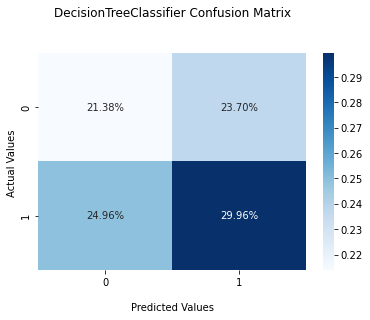

In [266]:
y_pred_dtc = model_dtc.predict(X_test)
print(type(model_dtc).__name__)
print("Accuracy score (training): ", model_dtc.score(X_train, y_train))
print("Accuracy score (validation): ",model_dtc.score(X_test, y_test))
print(classification_report(y_test, y_pred_dtc))
print("Confusion Matrix\n")
print(confusion_matrix(y_test, y_pred_dtc))
cf_matrix = confusion_matrix(y_test, y_pred_dtc)
ax = sns.heatmap(cf_matrix/np.sum(cf_matrix), annot=True, 
        fmt='.2%', cmap='Blues')

ax.set_title(type(model_dtc).__name__ + ' Confusion Matrix\n\n');
ax.set_xlabel('\nPredicted Values')
ax.set_ylabel('Actual Values ');


### DecisionTree - out of sample

DecisionTreeClassifier
Accuracy score (validation):  0.5476190476190477
              precision    recall  f1-score   support

          -1       0.56      0.53      0.54       129
           1       0.53      0.57      0.55       123

    accuracy                           0.55       252
   macro avg       0.55      0.55      0.55       252
weighted avg       0.55      0.55      0.55       252

Confusion Matrix

[[68 61]
 [53 70]]


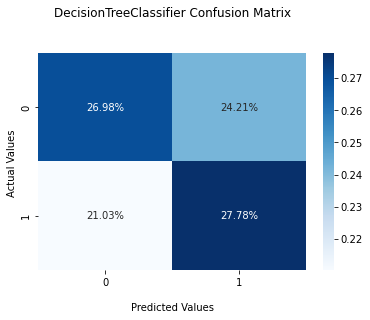

In [ ]:
y_pred_dtc = model_dtc.predict(X_hold)
print(type(model_dtc).__name__)
print("Accuracy score (validation): ", model_dtc.score(X_hold, y_hold))
print(classification_report(y_hold, y_pred_dtc))
print("Confusion Matrix\n")
print(confusion_matrix(y_hold, y_pred_dtc))
cf_matrix = confusion_matrix(y_hold, y_pred_dtc)
ax = sns.heatmap(cf_matrix/np.sum(cf_matrix), annot=True, 
        fmt='.2%', cmap='Blues')

ax.set_title(type(model_dtc).__name__ + ' Confusion Matrix\n\n');
ax.set_xlabel('\nPredicted Values')
ax.set_ylabel('Actual Values ');

### GradientBoosting - In sample

GradientBoostingClassifier
Accuracy score (training):  0.6608721928875883
Accuracy score (validation):  0.5363259668508288
              precision    recall  f1-score   support

          -1       0.49      0.51      0.50      6528
           1       0.58      0.56      0.57      7952

    accuracy                           0.54     14480
   macro avg       0.53      0.53      0.53     14480
weighted avg       0.54      0.54      0.54     14480

Confusion Matrix

[[3334 3194]
 [3520 4432]]


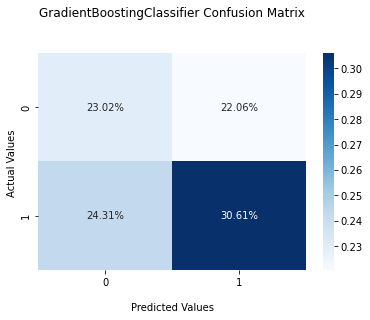

In [ ]:
# 

gb = gb1_2class
y_pred = gb.predict(X_test)

print(type(gb1).__name__)
print("Accuracy score (training): ", gb.score(X_train, y_train))
print("Accuracy score (validation): ",gb.score(X_test, y_test))
print(classification_report(y_test, y_pred))
print("Confusion Matrix\n")
print(confusion_matrix(y_test, y_pred))
cf_matrix = confusion_matrix(y_test, y_pred)
ax = sns.heatmap(cf_matrix/np.sum(cf_matrix), annot=True, 
        fmt='.2%', cmap='Blues')

ax.set_title(type(gb).__name__ + ' Confusion Matrix\n\n');
ax.set_xlabel('\nPredicted Values')
ax.set_ylabel('Actual Values ');

In [ ]:
# create the feature/predictor columns remove unnecessary
feature_cols = df.columns
feature_cols = feature_cols.drop(labels=['Target_class', 'Target', 'Ticker','Open', 'Adj Close','Close', 'High', 'Low', 'Volume', 'log_adj_price']).values.tolist()

In [ ]:
# KFold CV
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import KFold
 
X = df[feature_cols]
y = df['Target_class']
 
k = 4
kf = KFold(n_splits=k, random_state=None)
model =  GradientBoostingClassifier(n_estimators=10,random_state=0)
result = cross_val_score(model , X, y, cv = kf)
print("Avg accuracy: {}".format(result.mean()))


Avg accuracy: 0.7712995193104591


In [288]:
print("Accuracy score (training): ", gb1_2class.score(X_train, y_train))
print("Accuracy score (validation): ",gb1_2class.score(X_test, y_test))

print('\n',result)
print("Avg cross-validation: {}".format(result.mean()))

Accuracy score (training):  0.6608721928875883
Accuracy score (validation):  0.5363259668508288

 [0.75153323 0.76440687 0.78584452 0.78341345]
Avg cross-validation: 0.7712995193104591


GradientBoostingClassifier
Accuracy score (validation):  0.5555555555555556
              precision    recall  f1-score   support

          -1       0.56      0.64      0.60       129
           1       0.55      0.46      0.50       123

    accuracy                           0.56       252
   macro avg       0.56      0.55      0.55       252
weighted avg       0.56      0.56      0.55       252

Confusion Matrix

[[83 46]
 [66 57]]


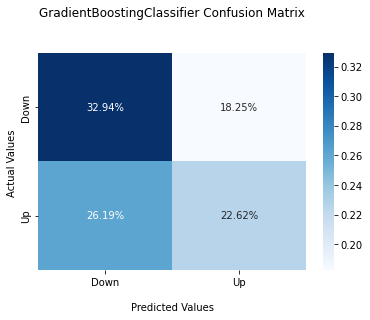

In [290]:
# Prediction on unseen X from holdback
gb1_prod = gb1_2class
y_pred= gb1_prod.predict(X_hold)

print(type(gb1_prod).__name__)
print("Accuracy score (validation): ",gb1_prod.score(X_hold, y_hold))
print(classification_report(y_hold, y_pred))
print("Confusion Matrix\n")
print(confusion_matrix(y_hold, y_pred))
cf_matrix = confusion_matrix(y_hold, y_pred)
ax = sns.heatmap(cf_matrix/np.sum(cf_matrix), annot=True, 
        fmt='.2%', cmap='Blues')

ax.set_title(type(gb1_prod).__name__ + ' Confusion Matrix\n\n');
ax.set_xlabel('\nPredicted Values')
ax.set_ylabel('Actual Values ')
ax.xaxis.set_ticklabels(['Down','Up'])
ax.yaxis.set_ticklabels(['Down','Up']);


### Get 3 classes (up, flat, down) from d (dataframe with the Target_class = TRI_Target)

In [276]:
#y_tri = d['Target_class']
#X_tri = d[feature_cols]
feature_cols_tri = d.columns
feature_cols_tri = feature_cols_tri.drop(labels=['Target_class', 'Target', 'Ticker','Open', 'Adj Close','Close', 'High', 'Low', 'Volume', 'log_adj_price', 'TRI_Target']).values.tolist()
X_train_tri, X_test_tri, y_train_tri, y_test_tri = get_X_y_train_test(d,feature_cols_tri, .2)

In [ ]:
# Used after initial model run to attempt to tune hyperparameters
from sklearn.model_selection import RandomizedSearchCV
gb_base = GradientBoostingClassifier(random_state=1,verbose=1)
gb_grid = {'n_estimators': [500],
               'max_depth': [3,4],
               'max_features': ['auto','log2'],
               'criterion': ['friedman_mse','squared_error'],
               'min_samples_split': [2,4]
            }

# setup the randmon search GradientBoost
gb_random = RandomizedSearchCV(estimator = gb_base, param_distributions = gb_grid, 
                               n_iter = 10, cv = 3, verbose = 10, random_state = 0, 
                               n_jobs = -1)

# Fit the random search model (for the TRI model)
gb_random.fit(X_train_tri, y_train_tri)

# Best parameters from the random search
gb_random.best_params_

Fitting 3 folds for each of 10 candidates, totalling 30 fits


KeyboardInterrupt: ignored

101

In [ ]:
gb_tri = GradientBoostingClassifier(n_estimators=500,
                                    random_state=0,verbose=1)
#gb_tri = GradientBoostingClassifier(n_estimators=500,random_state=0,verbose=1)
gb_tri.fit(X_test_tri, y_test_tri)

      Iter       Train Loss   Remaining Time 
         1           1.0565           13.76m
         2           1.0495           12.26m
         3           1.0435           11.68m
         4           1.0383           11.43m
         5           1.0339           11.27m
         6           1.0299           11.90m
         7           1.0264           11.83m
         8           1.0234           11.66m
         9           1.0205           11.53m
        10           1.0181           11.42m
        20           1.0004           10.83m
        30           0.9894           10.51m
        40           0.9810           10.54m
        50           0.9747           10.24m
        60           0.9688            9.97m
        70           0.9628            9.70m
        80           0.9577            9.60m
        90           0.9522            9.34m
       100           0.9459            9.09m
       200           0.8941            6.81m
       300           0.8475            4.58m
       40

GradientBoostingClassifier(n_estimators=500, random_state=0, verbose=1)

In [ ]:
import pickle
with open('gb_model_tri.pkl', 'wb') as files:
  pickle.dump (gb_tri, files)
with open('gb_model_tri.pkl', 'rb') as files:
  gb_tri = pickle.load(files)               

### GradientBoost (TRI) In sample

GradientBoostingClassifier
Accuracy score (training):  0.49941294288279575
Accuracy score (validation):  0.7243093922651934
              precision    recall  f1-score   support

          -1       0.91      0.47      0.62      3534
           0       0.67      0.92      0.78      6551
           1       0.76      0.64      0.70      4395

    accuracy                           0.72     14480
   macro avg       0.78      0.68      0.70     14480
weighted avg       0.76      0.72      0.71     14480

Confusion Matrix

[[1656 1404  474]
 [ 105 6003  443]
 [  67 1499 2829]]


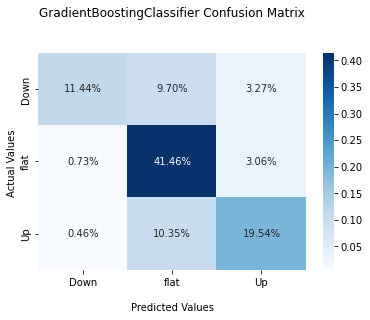

In [267]:
y_pred_tri = gb_tri.predict(X_test_tri)
print(type(gb_tri).__name__)
print("Accuracy score (training): ",gb_tri.score(X_train_tri, y_train_tri))
print("Accuracy score (validation): ",gb_tri.score(X_test_tri, y_test_tri))
print(classification_report(y_test_tri, y_pred_tri))
print("Confusion Matrix\n")
print(confusion_matrix(y_test_tri, y_pred_tri))
cf_matrix = confusion_matrix(y_test_tri, y_pred_tri)
ax = sns.heatmap(cf_matrix/np.sum(cf_matrix), annot=True, 
        fmt='.2%', cmap='Blues')

ax.set_title(type(gb_tri).__name__ + ' Confusion Matrix\n\n');
ax.set_xlabel('\nPredicted Values')
ax.set_ylabel('Actual Values ')
ax.xaxis.set_ticklabels(['Down','flat','Up'])
ax.yaxis.set_ticklabels(['Down','flat','Up']);


### Gradient Boost TRI Out of Sample

In [277]:
dhold = copy.deepcopy(holdback_1yr)
dhold['Target'].describe()

count    252.000000
mean      -0.001691
std        0.031906
min       -0.098841
25%       -0.020764
50%       -0.001009
75%        0.018071
max        0.103159
Name: Target, dtype: float64

In [278]:
holdback_1yr["TRI_Target"] = holdback_1yr.apply(lambda x: get_tri_state(x, .018), axis = 1)
dhold['Target_class'] = holdback_1yr['TRI_Target']
X_hold_tri = dhold[feature_cols_tri]
y_hold_tri = dhold["Target_class"]

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [279]:
dhold['Target_class'].value_counts().sort_index()

-1     69
 0    120
 1     63
Name: Target_class, dtype: int64

In [285]:
y_pred_tri = gb_tri.predict(X_hold_tri)
y_score_tri = gb_tri.predict_proba(X_hold_tri)

GradientBoostingClassifier
Accuracy score (validation):  0.36507936507936506
              precision    recall  f1-score   support

          -1       0.28      0.39      0.33        69
           0       0.62      0.26      0.36       120
           1       0.32      0.54      0.40        63

    accuracy                           0.37       252
   macro avg       0.41      0.40      0.36       252
weighted avg       0.45      0.37      0.36       252

Confusion Matrix

[[27 13 29]
 [45 31 44]
 [23  6 34]]


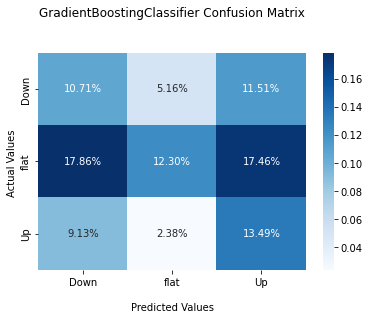

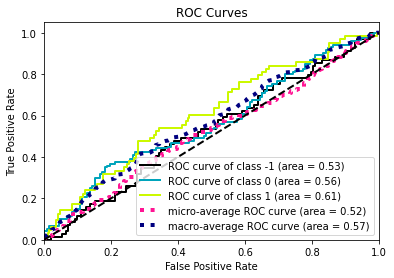

In [286]:
print(type(gb_tri).__name__)
print("Accuracy score (validation): ",gb_tri.score(X_hold_tri, y_hold_tri))
print(classification_report(y_hold_tri, y_pred_tri))
print("Confusion Matrix\n")
print(confusion_matrix(y_hold_tri, y_pred_tri))
cf_matrix = confusion_matrix(y_hold_tri, y_pred_tri)
ax = sns.heatmap(cf_matrix/np.sum(cf_matrix), annot=True, 
        fmt='.2%', cmap='Blues')

ax.set_title(type(gb_tri).__name__ + ' Confusion Matrix\n\n');
ax.set_xlabel('\nPredicted Values')
ax.set_ylabel('Actual Values ');
ax.xaxis.set_ticklabels(['Down','flat','Up'])
ax.yaxis.set_ticklabels(['Down','flat','Up'])

plot_roc(y_hold_tri, y_score_tri)
plt.show()

### Odds additions

In [ ]:
feature_cols_tri = d.columns
feature_cols_tri = feature_cols_tri.drop(labels=['Target_class', 'Target', 'Ticker','Open', 'Adj Close','Close', 'High', 'Low', 'Volume', 'log_adj_price', 'TRI_Target']).values.tolist()
X_train_tri, X_test_tri, y_train_tri, y_test_tri = get_X_y_train_test(d,feature_cols_tri, .2)

In [ ]:
y_hat= gb_tri.predict_proba(X_train_tri)

In [ ]:
tmp = d.head(len(X_train_tri))

In [ ]:
tmp['down'] = y_hat[:,0]
tmp['in_between'] = y_hat[:,1]
tmp['up'] = y_hat[:,2]
tmp['odds_down'] = tmp['down']/tmp['up']
tmp['odds_up'] = tmp['up']/tmp['down']

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:3: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/st

In [ ]:
fig= px.scatter(tmp, x = 'up', y = 'Target', trendline='ols', width=700 )
fig.data[1].update(line_color='red')
fig.show() 

In [ ]:
fig= px.scatter(tmp, x = 'down', y = 'Target', trendline='ols', width=700 )
fig.data[1].update(line_color='red')
fig.show()

In [ ]:
fig= px.scatter(tmp, x = 'down', y = 'odds_down',color ='TRI_Target', width=700).show()

In [ ]:
fig= px.scatter(tmp, x = 'up', y = 'odds_up', color = 'TRI_Target', width=700).show()

In [ ]:
up = tmp[tmp['odds_up']>.8]

In [ ]:
up['cumul_pnl'] = up['Target'].cumsum()

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [ ]:
up.reset_index(inplace = True)
fig = px.line(up, y = 'cumul_pnl', width=700).show()

In [ ]:
down = tmp[tmp['odds_down']>.8]

In [ ]:
down['cumul_pnl'] = down['Target'].cumsum()

up['side'] = 1
down['side'] = -1

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:3: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:4: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/st

In [ ]:
combo = up.append(down)
combo['perf'] = combo['side']*combo['Target']
combo.sort_values('Date', inplace = True)
combo['cumul_perf'] = combo['perf'].cumsum()


In [291]:
combo.head()

,Date,Ticker,Open,Close,High,Low,Volume,Adj Close,log_adj_price,RSI_2,RSI_3,RSI_5,RSI_6,RSI_14,SMA_5,SMA_10,SMA_20,EMA_5,EMA_10,EMA_20,Lag_1,Lag_2,Lag_3,Lag_4,Lag_week,Lag_month,Target,Target_class,MFI,volume_adi,volume_obv,volume_cmf,volume_fi,volume_em,volume_sma_em,volume_vpt,volume_vwap,volume_mfi,volume_nvi,volatility_bbm,volatility_bbh,volatility_bbl,volatility_bbw,volatility_bbp,volatility_bbhi,volatility_bbli,volatility_kcc,volatility_kch,volatility_kcl,volatility_kcw,volatility_kcp,volatility_kchi,volatility_kcli,volatility_dcl,volatility_dch,volatility_dcm,volatility_dcw,volatility_dcp,volatility_atr,volatility_ui,trend_macd,trend_macd_signal,trend_macd_diff,trend_sma_fast,trend_sma_slow,trend_ema_fast,trend_ema_slow,trend_vortex_ind_pos,trend_vortex_ind_neg,trend_vortex_ind_diff,trend_trix,trend_mass_index,trend_dpo,trend_kst,trend_kst_sig,trend_kst_diff,trend_ichimoku_conv,trend_ichimoku_base,trend_ichimoku_a,trend_ichimoku_b,trend_stc,trend_adx,trend_adx_pos,trend_adx_neg,trend_cci,trend_visual_ichimoku_a,trend_visual_ichimoku_b,trend_aroon_up,trend_aroon_down,trend_aroon_ind,momentum_rsi,momentum_stoch_rsi,momentum_stoch_rsi_k,momentum_stoch_rsi_d,momentum_tsi,momentum_uo,momentum_stoch,momentum_stoch_signal,momentum_wr,momentum_ao,momentum_roc,momentum_ppo,momentum_ppo_signal,momentum_ppo_hist,momentum_pvo,momentum_pvo_signal,momentum_pvo_hist,momentum_kama,others_dr,others_dlr,others_cr,TRI_Target,down,in_between,up,odds_down,odds_up,cumul_pnl,side,perf,cumul_perf
35291,2016-02-02,AMAT,17.400000,17.049999,17.430000,16.990000,11379600,15.670323,2.751769,-0.911681,-0.631636,-0.435637,-0.424575,-0.748000,-1.187249,-1.192108,-1.194391,-1.187446,-1.190278,-1.193962,-0.033994,-0.033994,0.022182,-0.002341,-0.017291,-0.076881,0.013881,1,-0.490498,2.490572,-2.725300,0.828580,-11.631997,-2.911698,-1.463246,-11.419153,0.207430,-1.744968,-1.100324,0.327325,0.860970,-0.295413,2.146686,-3.395577,-0.292663,4.561669,0.126770,0.150705,0.101139,1.340884,-8.912351,-0.348977,1.083737,-1.174358,0.455414,-0.298159,3.949994,-0.792959,5.165699,2.616616,-3.330519,-1.906070,-5.241773,0.178317,0.439912,0.092089,0.329581,0.853636,1.987037,-1.427669,-1.226215,-0.172942,1.106921,-2.025385,-1.367445,-2.151794,-0.403712,-0.146650,-0.277566,-0.113598,-1.263191,0.930303,-0.702190,5.618387,-4.856620,0.864415,0.762495,-1.825329,1.772719,-2.041455,-3.049229,-1.493983,-0.643672,-0.712067,-2.136897,-0.397039,-0.481491,-0.304391,-0.481491,-3.398353,-7.499172,-2.093641,-1.095357,-4.133002,0.304715,0.571296,-0.229288,-0.039201,-23.716725,-31.957180,-1.190726,1,0.178360,0.669183,0.152456,1.169912,0.854765,55.339018,1,0.013881,0.013881
16472,2016-02-02,NFLX,95.540001,91.489998,96.650002,90.730003,21906500,91.489998,4.516230,-0.836966,-0.958255,-1.273009,-1.388675,-1.912187,-1.438822,-1.408352,-1.360095,-1.432980,-1.410930,-1.365405,-0.027633,-0.003811,-0.030929,0.003730,-0.064806,-0.167970,-0.008265,0,-2.011081,-2.026806,-2.331217,-8.597912,-10.678294,-2.300659,-0.065922,-15.353681,-1.037044,-0.561923,-0.034397,-0.597556,-0.335110,-0.881630,2.078239,-3.499913,-0.315994,5.201596,-0.618540,-0.633966,-0.601908,-0.981156,-15.669660,-0.599360,2.308172,-1.370261,-0.579005,-0.953610,4.062655,-1.942156,1.685852,1.813687,-1.090641,-0.114017,-2.997444,-0.616715,-0.592605,-0.672531,-0.620311,-0.172041,-0.034821,-0.071894,-0.004183,0.857015,0.441032,-0.425671,-0.050919,-1.090859,-0.955709,-0.953011,-0.955531,-0.951966,0.513173,0.326376,-2.080920,5.798998,-6.184298,-0.547130,-0.612987,0.967730,1.727643,-0.448580,-3.421012,-1.473556,0.212976,1.007360,-1.485161,-4.662043,-1.929907,-0.105458,-1.929907,-0.831901,-6.270401,-1.029024,0.007835,-3.426282,4.245273,0.793946,6.775293,-0.804595,-21.294377,-27.799748,-1.447323,0,0.330766,0.505314,0.163920,2.017847,0.495578,-6.785445,-1,0.008265,0.022146
13853,2016-02-02,AMD,2.110000,1.990000,2.140000,1.960000,11224100,1.990000,0.688135,-1.266124,-1.109117,-0.980854,-1.000720,-1.503951,-1.030413,-1.032604,-1.030852,-1.031414,-1.03

In [ ]:
fig = px.line(combo, x=combo['Date'], y =combo['cumul_perf'],width=700)
fig.show()

In [ ]:
fig = px.line(up, y =up['cumul_pnl'],width=700)
fig.show()

In [ ]:

fig = px.line(down, y =down['cumul_pnl'],width=700)
fig.show()

## Create the Profit and Loss (P&L)
**Note: currently across all 50 stocks ...

In [292]:
# with -1(class0),0(class1),1(class2) , proba matrix is N,3; select the class 1(up) to get those proba
tprob_up = gb_tri.predict_proba(X_test_tri)[:,2]
tprob_flat = gb_tri.predict_proba(X_test_tri)[:,1]
tprob_down = gb_tri.predict_proba(X_test_tri)[:,0]

print('Tprob up, flat, down: ' , tprob_up.shape, tprob_flat.shape, tprob_down.shape)

Tprob up, flat, down:  (14480,) (14480,) (14480,)


In [293]:
print('Test up len: ',len(tprob_up))
print('Test down len: ',len(tprob_down))
# check for the correct proba matrix (class probabilities should add to 1 for every row)
(unique, counts) = np.unique((tprob_up + tprob_down), return_counts=True)
frequencies = np.asarray((unique, counts)).T

print(frequencies)

Test up len:  14480
Test down len:  14480
[[0.05079194 1.        ]
 [0.05818059 1.        ]
 [0.06509404 1.        ]
 ...
 [0.97560881 1.        ]
 [0.97705874 1.        ]
 [0.97874742 1.        ]]


In [294]:
%%capture
# setup the PnL
def setup_PnL (tproba_up, X_t):
  testd = df.tail(len(X_t))
  testd['Prob_up'] = tproba_up
  testd['Signal'] = testd['Prob_up'] - .5
  testd['Prediction'] = np.sign(testd['Signal'])
  testd['PnL'] = testd['Prediction'] * testd['Target']
  testd['Cumul_PnL'] = testd['PnL'].cumsum()
  return testd

t_data_all = setup_PnL(tprob_up, X_test)



In [295]:
t_data_all['Prediction'].value_counts()

-1.0    13114
 1.0     1366
Name: Prediction, dtype: int64

In [296]:
t_data_all['Target_class'].value_counts()

 1    7952
-1    6528
Name: Target_class, dtype: int64

In [297]:
preds_target_df = t_data_all[['Prediction','Target_class']].copy().astype(int)

In [298]:
px.line(preds_target_df.iloc[-100:], width=900, height=400, title="", ).show()

In [299]:
print('t_data ' 'All:' , t_data_all.shape)

t_data All: (14480, 116)


In [300]:
%%capture
t_data_all['Group'] = 'All'

In [302]:
fig = go.Figure(data=[go.Histogram(x=t_data_all['Signal'],name="All Stocks"),])

fig.update_layout(barmode='overlay')
fig.update_traces(overwrite=True) 
fig.update_layout(
    title="Histograms of Signals",
    xaxis_title="Signal",
    yaxis_title="Count",
    legend_title="Groups"
    )
fig.show()

In [307]:
%%capture
t_refined_signal = t_data_all[abs(t_data_all['Signal']) < .058]
t_refined_signal['Cumul_PnL'] = t_refined_signal['PnL'].cumsum()
len(t_refined_signal), len(t_data_all)

In [308]:
# Setup the stock dictionary key is stock, values are the features (if necessary)
stocks_dict = {}
keys = range(len(stocks))
values = stocks
for i in keys:
  stocks_dict[i] = values[i]
print (stocks_dict)

def get_swap_dict(d):
    return {v : k for k, v in d.items()}

stock_swap = get_swap_dict(stocks_dict)

{0: 'AAPL', 1: 'MSFT', 2: 'GOOG', 3: 'NVDA', 4: 'META', 5: 'ASML', 6: 'AVGO', 7: 'ORCL', 8: 'ADBE', 9: 'CRM', 10: 'AMZN', 11: 'TSLA', 12: 'TSM', 13: 'TCEHY', 14: 'BABA', 15: 'CSCO', 16: 'QCOM', 17: 'TXN', 18: 'AMD', 19: 'INTC', 20: 'CDNS', 21: 'ADP', 22: 'NFLX', 23: 'NOW', 24: 'INTU', 25: 'IBM', 26: 'PYPL', 27: 'SAP', 28: 'SONY', 29: 'JD', 30: 'AMAT', 31: 'ADI', 32: 'ADSK', 33: 'BKNG', 34: 'MRVL', 35: 'LRCX', 36: 'MU', 37: 'TEAM', 38: 'FISV', 39: 'EQIX', 40: 'ATVI', 41: 'VMW', 42: 'NTES', 43: 'FIS', 44: 'KLAC', 45: 'SNPS', 46: 'PANW', 47: 'SHOP', 48: 'MELI', 49: 'SQ'}


## Create a Dropdown for stock group selection and model results (with select All)

In [ ]:
from pandas.core.algorithms import diff
from jupyter_dash import JupyterDash
from dash import Dash, html, dcc, Input, Output
import pandas as pd
import plotly.express as px
import dash_bootstrap_components as dbc

app = JupyterDash(__name__, external_stylesheets=[dbc.themes.BOOTSTRAP])
#app = Dash(__name__)
#use JupytrDash runtime, can't get the inline mode working
#key dataframe is dfmm

#set up to allow selection of features
group_options = dict_stocks
#up_options = {"Select All" : 'All Stocks'}
#up_options.update(all_options)
#all_options = up_options

app.layout = html.Div(
    [
      dbc.Row(
          [
            dbc.Col(
                dbc.Row(
                    [
                      html.Label(['Choose a Stock Group: ', html.Br(), ' All 50 Selected Stocks', 
                                  html.Br(), 'Group 1 ["Meta","AMZN","AAPL", "NFLX", "GOOG"]',html.Br(), 'Group 2 ["TSLA","AMD","VMW", "PANW", "IBM", "CSCO", "BABA", "NOW", "SHOP", "SQ"]'],style={'font-weight': 'bold'}),
                        #dcc.Checklist(feature_cols,id='indicator-checklist',
                        #labelStyle={'display': 'block'}
                        #),
                        dcc.Dropdown(
                        id='stock-dropdown', 
                        options = list(group_options.keys()),
                        value='all_values',  
                        multi=True,
                      ),
                      dcc.RadioItems(list(dict_classifiers.keys()),id='model_radio',
                      labelStyle={'display': 'block'}
                      ),  
                      html.Hr(),
                      html.Div(id='display-selected-values'),
                    ],
                    justify="center",
                ),
            ),        
            dbc.Col(
                dbc.Row(
                    [
                      
                      html.Div([
                        #dcc.Graph(id='stock-graph'),
                        dcc.Graph(id='stock-graph', figure='fig'),
                        #dcc.Graph(id='indicator-graph', figure='fig2'),
                        dcc.Graph(id='pnl-graph', figure='fig3'),
                        #print (dfm.head()),
                      ]
                      ),
                    ],
                ),
            ),
          ],
          justify="center",
      ),
    ],
)



@app.callback(
    Output(component_id = 'stock-graph', component_property = 'figure'),
    Input(component_id = 'stock-dropdown', component_property = 'value'))

def update_stock_graph (selected_stock):
  # dfmm - complete dataframe with all the selected stocks
    # filtering below
    if selected_stock == 'Select All':
      dff = df[df.Ticker == 'AAPL']
    else:
      dff = df[df.Ticker.isin(selected_stock)]

    dff['Date'] = dff.index
    fig = go.Figure(data=[go.Candlestick(x=dff['Date'],
                open=dff['Open'],
                high=dff['High'],
                low=dff['Low'],
                close=dff['Close'])])
    fig.update_layout(xaxis_rangeslider_visible=False)
    fig.show(renderer="colab")
    return fig

@app.callback(
    Output(component_id = 'pnl-graph', component_property = 'figure'),
    Input(component_id = 'stock-dropdown', component_property = 'value'),
    Input(component_id = 'indicator-checklist', component_property ='value'))
def update_PnL_graph (selected_stock, selected_indicators):
    
    dff = df[df.Ticker.isin(selected_stock)]
    dff['Date'] = dff.index

    # Get the training and test data
    X_train, X_test, y_train, y_test = get_X_y_train_test (dff, selected_indicators,.2)

    # Our selected (best) classifier
    gb = GradientBoostingClassifier(n_estimators=50, learning_rate=learning_rate, max_features=3, max_depth=2, random_state=0,verbose=1)
    gb.fit(X_train, y_train)

    # with -1(class0),1(class1) , proba matrix is N,2; select the class 1(up) to get those probabilities
    test_proba_up = gb.predict_proba(X_test)[:,1]
    test_data = dff.tail(len(X_test))

    # setup the PnL
    test_data['Prob_up'] = test_proba_up
    test_data['Signal'] = test_data['Prob_up'] - .5
    test_data['Prediction'] = np.sign(test_data['Signal'])

    test_data['PnL'] = test_data['Prediction'] * test_data['Target']
    test_data['Cumul_PnL'] = test_data['PnL'].cumsum()
    fig3 = px.scatter(test_data, x='Prob_up', y='PnL', color='Ticker', trendline="ols", opacity=.75, title="PnL and Probabilities (class 1=up)", width=500)
    return fig3

@app.callback(
    Output(component_id = 'indicator-graph', component_property = 'figure'),
    Input(component_id = 'stock-dropdown', component_property = 'value'),
    Input(component_id = 'indicator-checklist', component_property ='value'))
def update_indicator_graph (selected_stock,selected_indicator):
    dff2 = df[df.Ticker.isin(selected_stock)]
    dff2['Date'] = dff.index
    fig2 = px.line(dff2, x = "Date", y = selected_indicator, width=900, height=400, title="Indicator")
    fig2.update_xaxes(rangeslider_visible=True)
    #fig = px.scatter(x=dfm[dfm['Ticker'] == 'AAPL' ].index, y=dfm[dfm['Ticker'] == 'AAPL']['Close'])    
    return fig2


@app.callback(
    Output('indicator-radio', 'options'),
    Input('stock-dropdown', 'value'))
def set_indicator_options(selected_stock):
    return [{'label': i, 'value': i} for i in all_options[selected_stock]]

@app.callback(
    Output('indicator-checklist', 'value'),
    Input('indicator-checklist', 'options'))
def set_indicator_value(available_options):
    return available_options[0]['value']


@app.callback(
    Output('display-selected-values', 'children'),
    Input('stock-dropdown', 'value'),
    Input('indicator-checklist', 'value'))
def set_display_children(selected_stock, selected_indicator):
    return '{} model for {}'.format(
        selected_indicator, selected_stock,
    )

# to run in colab
#app.run_server(mode='inline') - rendering to colab didn't work as well, will need to solve
if __name__ == '__main__':
    app.run_server(debug=False, port=8030)

 * Running on http://127.0.0.1:8030/ (Press CTRL+C to quit)
127.0.0.1 - - [13/Aug/2022 23:50:14] "GET /_alive_8bf1ca3a-5abe-41b2-8212-483e7a0e00a7 HTTP/1.1" 200 -


Dash app running on http://127.0.0.1:8030/


127.0.0.1 - - [13/Aug/2022 23:50:29] "GET / HTTP/1.1" 200 -
127.0.0.1 - - [13/Aug/2022 23:50:29] "GET /_dash-component-suites/dash/deps/polyfill@7.v2_5_1m1657301353.12.1.min.js HTTP/1.1" 200 -
127.0.0.1 - - [13/Aug/2022 23:50:29] "GET /_dash-component-suites/dash/deps/react@16.v2_5_1m1657301353.14.0.min.js HTTP/1.1" 200 -
127.0.0.1 - - [13/Aug/2022 23:50:29] "GET /_dash-component-suites/dash/deps/react-dom@16.v2_5_1m1657301353.14.0.min.js HTTP/1.1" 200 -
127.0.0.1 - - [13/Aug/2022 23:50:29] "GET /_dash-component-suites/dash/deps/prop-types@15.v2_5_1m1657301353.8.1.min.js HTTP/1.1" 200 -
127.0.0.1 - - [13/Aug/2022 23:50:29] "GET /_dash-component-suites/dash_bootstrap_components/_components/dash_bootstrap_components.v1_2_1m1660448452.min.js HTTP/1.1" 200 -
127.0.0.1 - - [13/Aug/2022 23:50:29] "GET /_dash-component-suites/dash/dcc/dash_core_components.v2_5_0m1657301353.js HTTP/1.1" 200 -
127.0.0.1 - - [13/Aug/2022 23:50:29] "GET /_dash-component-suites/dash/dash-renderer/build/dash_render

127.0.0.1 - - [13/Aug/2022 23:50:42] "POST /_dash-update-component HTTP/1.1" 200 -
